## <center> Dimensionality Reduction (Principal Component Analysis (PCA) and t-Distributed Stochastic Neighbor Embedding (t-SNE) for Instant Coffee </center>

In [2]:
# Load packages 
import os 
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE


In [3]:
# set the working directory 
os.chdir('C:\\Users\\abc\\OneDrive - UGent\\Documenten\\Derick Malavi_PhD Docs_UGent\\Manuscript 4_Coffee\\Instant_Coffee\\Exploratory_Data_Analysis')

In [4]:
# Read_data. Import the files for instant coffee
instant_raw = pd.read_excel('instant_coffee_raw.xlsx')
instant_msc_sg_1d = pd.read_excel('coffee_instant_msc_sg_1d.xlsx')
instant_msc_sg_2d = pd.read_excel('coffee_instant_msc_sg_2d.xlsx')
instant_snv_sg_1d = pd.read_excel('coffee_instant_snv_sg_1d.xlsx')
instant_snv_sg_2d = pd.read_excel('coffee_instant_snv_sg_2d.xlsx')

In [5]:
instant_raw.head()

,sample_name,binary_class,three_class,cal_val,perc_adulter,935.609985,939.059998,942.52002,945.97998,949.429993,...,1688.02002,1691.589966,1695.170044,1698.75,1702.329956,1705.910034,1709.48999,1713.069946,1716.650024,1720.22998
0,Arabica_10,pure_arabica,pure_arabica,1,0,0.530853,0.533619,0.561054,0.582093,0.596901,...,0.540360,0.536110,0.532238,0.528059,0.525007,0.521218,0.516975,0.511108,0.504414,0.496085
1,Arabica_10,pure_arabica,pure_arabica,1,0,0.533290,0.535996,0.563077,0.583506,0.597973,...,0.539968,0.535841,0.532169,0.528426,0.525502,0.522217,0.517889,0.511993,0.505306,0.497512
2,Arabica_10,pure_arabica,pure_arabica,1,0,0.531486,0.534291,0.561071,0.581973,0.596549,...,0.545723,0.541324,0.537376,0.532705,0.529344,0.525174,0.520571,0.514255,0.507121,0.499195
3,Arabica_11,pure_arabica,pure_arabica,1,0,0.563388,0.566406,0.596824,0.619869,0.635869,...,0.541186,0.537560,0.534226,0.530944,0.528720,0.525882,0.521746,0.516036,0.510318,0.502815
4,Arabica_11,pure_arabica,pure_arabica,1,0,0.560974,0.563901,0.593892,0.617615,0.633946,...,0.540318,0.536781,0.533500,0.530279,0.527773,0.524809,0.520953,0.515072,0.509542,0.502504


In [6]:
# Select the X columns
X_raw = instant_raw.iloc[:,5:230]
X_msc_sg_1d = instant_msc_sg_1d.iloc[:,5:230]
X_msc_sg_2d = instant_msc_sg_2d.iloc[:,5:230]
X_snv_sg_1d = instant_snv_sg_1d.iloc[:,5:230]
X_snv_sg_2d = instant_snv_sg_2d.iloc[:,5:230]

print(X_raw.shape) 
print(X_msc_sg_1d.shape)
print(X_msc_sg_2d.shape)
print(X_snv_sg_1d.shape)
print(X_msc_sg_2d.shape)

(1476, 224)
(1476, 224)
(1476, 224)
(1476, 224)
(1476, 224)


In [7]:
# Subset the categorical variable 
three_class = instant_raw['three_class']

# Subset the percentage adulteration 
percent_adult = instant_raw['perc_adulter']
 
print(three_class.shape)    

(1476,)


In [8]:
# Raw Spectra Instant Coffee
# Apply t-SNE to reduce dimensions to 2D

# Scale the data 
scaler = StandardScaler()
X_raw_scaled = scaler.fit_transform(X_raw)

tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42,init='pca')
X_tsne = tsne.fit_transform(X_raw_scaled)

# Convert to DataFrame for plotting
tsne_df = pd.DataFrame(X_tsne, columns=['TSNE1', 'TSNE2'])
tsne_df[['Class', 'adulter_percent']] = instant_raw[['three_class','perc_adulter']]  # Add labels

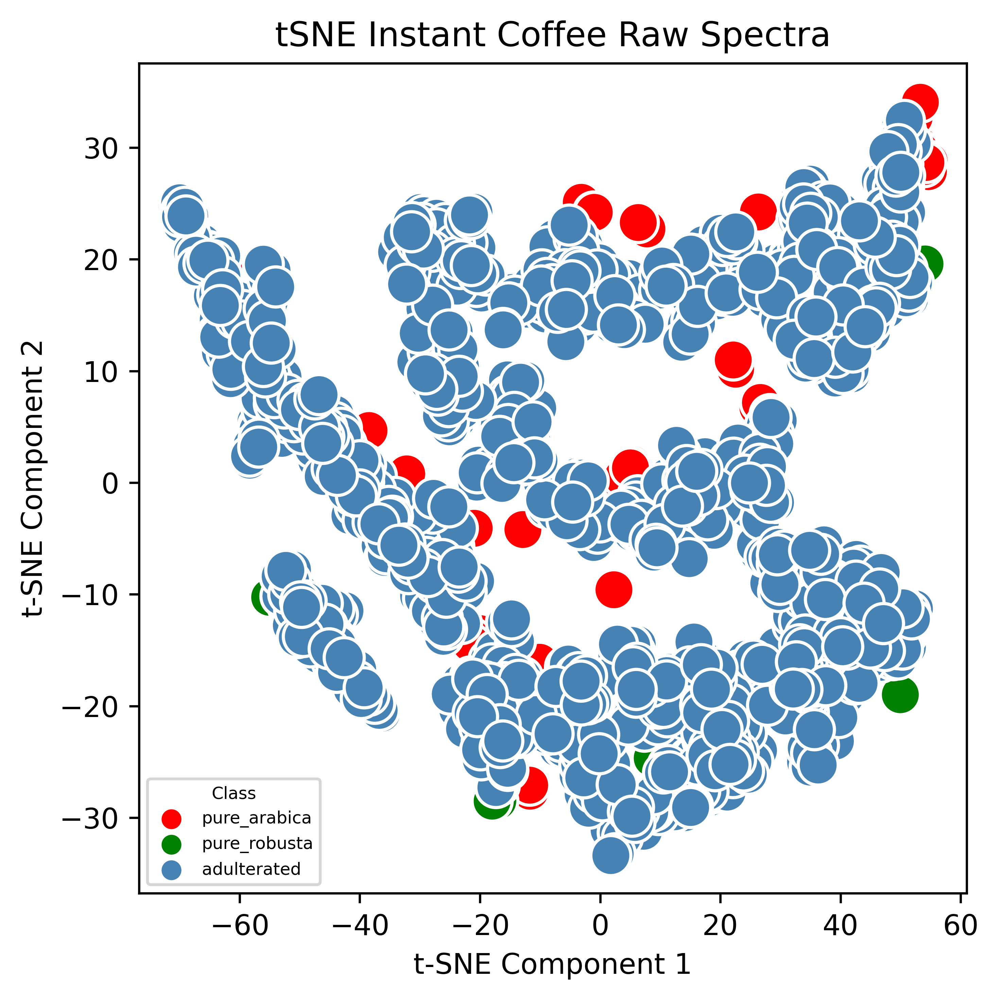

In [9]:
# Plotting 
plt.figure(figsize=(5, 5), dpi=600)
palette = {"adulterated": "steelblue", "pure_arabica": "red", "pure_robusta": "green"}
# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'Class',
                palette=palette, alpha=1.0, s=200)
plt.title("tSNE Instant Coffee Raw Spectra")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title="Class", loc='lower left', fontsize=6, title_fontsize=6)
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Instant_Raw.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

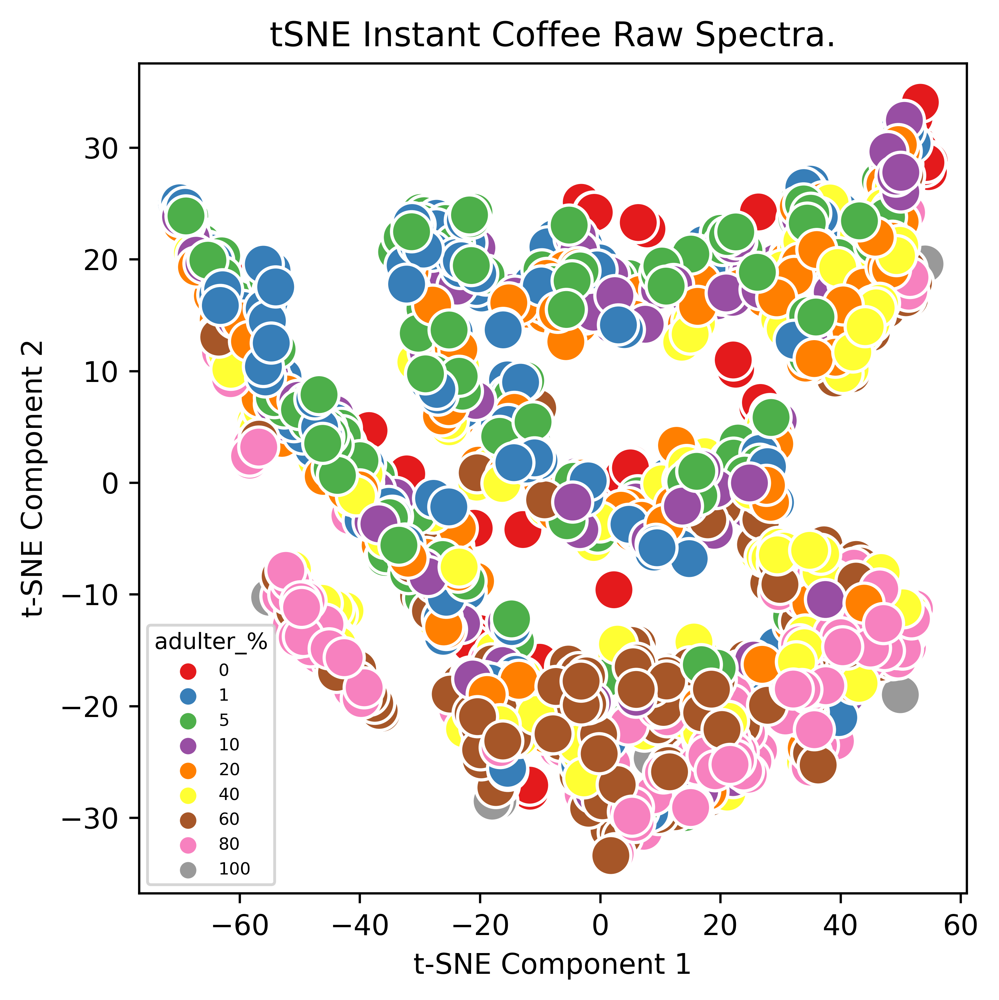

In [10]:
# Plotting-Adulteration percentage
plt.figure(figsize=(5, 5), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'adulter_percent',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Instant Coffee Raw Spectra.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title='adulter_%', prop={'size': 6}, loc='best', markerscale=0.8, title_fontsize=8)
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Instant_Raw_adult_percent.png", dpi=600, bbox_inches="tight", format="png")
plt.show()


In [11]:
# MSC+SG+first derivative Instant Coffee

# Apply t-SNE to reduce dimensions to 2D
tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42,init='pca')
X_tsne = tsne.fit_transform(X_msc_sg_1d)

# Convert to DataFrame for plotting
tsne_df = pd.DataFrame(X_tsne, columns=['TSNE1', 'TSNE2'])
tsne_df[['Class', 'adulter_percent']] = instant_msc_sg_1d[['three_class','perc_adulter']] 

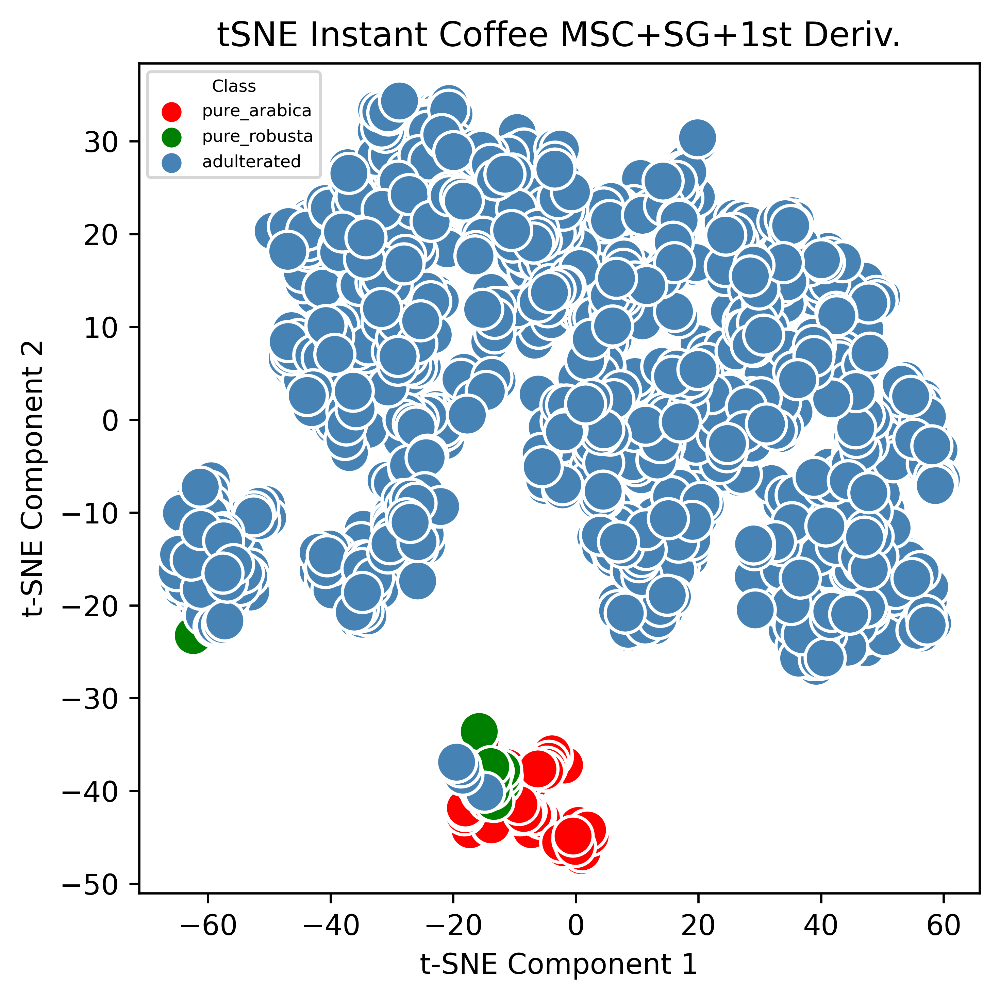

In [12]:
# Plotting 
plt.figure(figsize=(5, 5), dpi=600)
palette = {"adulterated": "steelblue", "pure_arabica": "red", "pure_robusta": "green"}
# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'Class',
                palette=palette, alpha=1.0, s=200)
plt.title("tSNE Instant Coffee MSC+SG+1st Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title="Class", loc = 'upper left',fontsize=6, title_fontsize=6)
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Instant_MSC_1D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

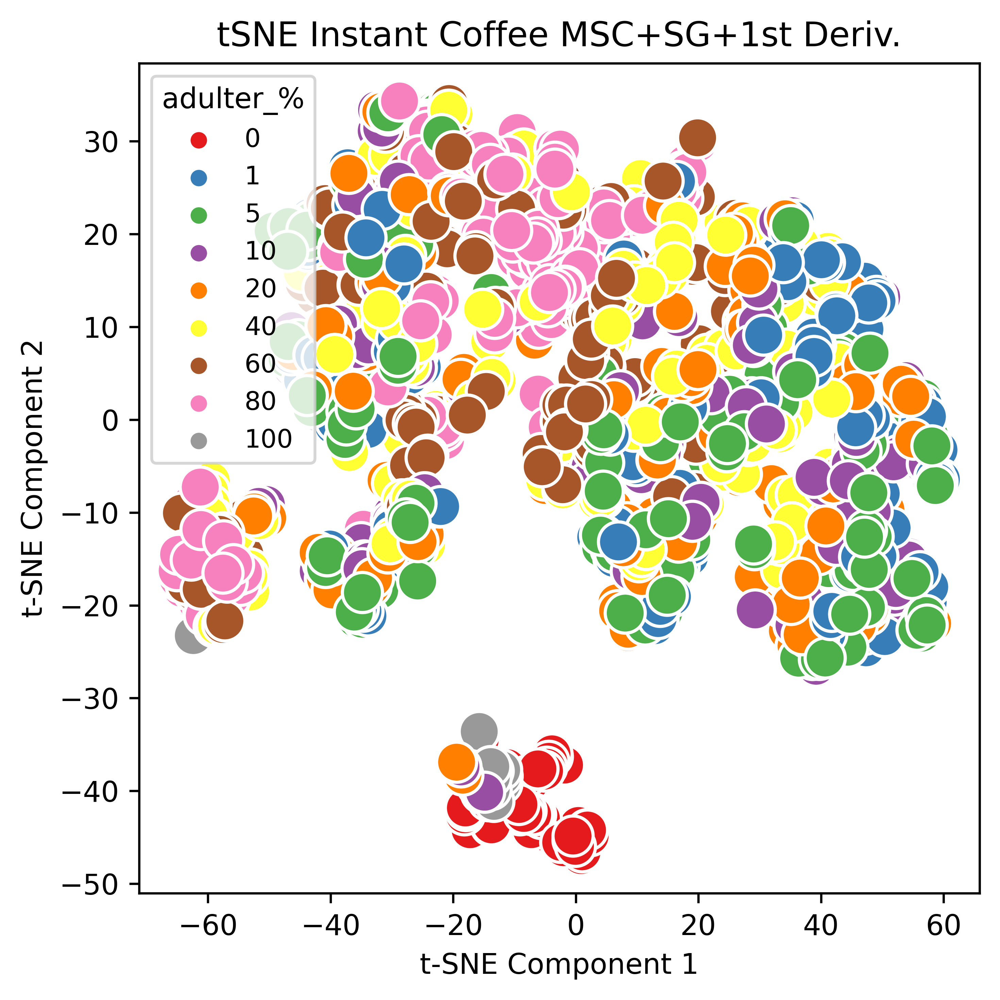

In [13]:
# Plotting 
plt.figure(figsize=(5, 5), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'adulter_percent',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Instant Coffee MSC+SG+1st Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title='adulter_%', prop={'size': 9}, loc='best', markerscale=0.8)
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Instant_MSC_1D_adult_percent.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

In [14]:
# MSC+SG+second derivative Instant Coffee

# Apply t-SNE to reduce dimensions to 2D
tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42,init='pca')
X_tsne = tsne.fit_transform(X_msc_sg_2d)

# Convert to DataFrame for plotting
tsne_df = pd.DataFrame(X_tsne, columns=['TSNE1', 'TSNE2'])
tsne_df[['Class', 'adulter_percent']] = instant_msc_sg_2d[['three_class','perc_adulter']] 

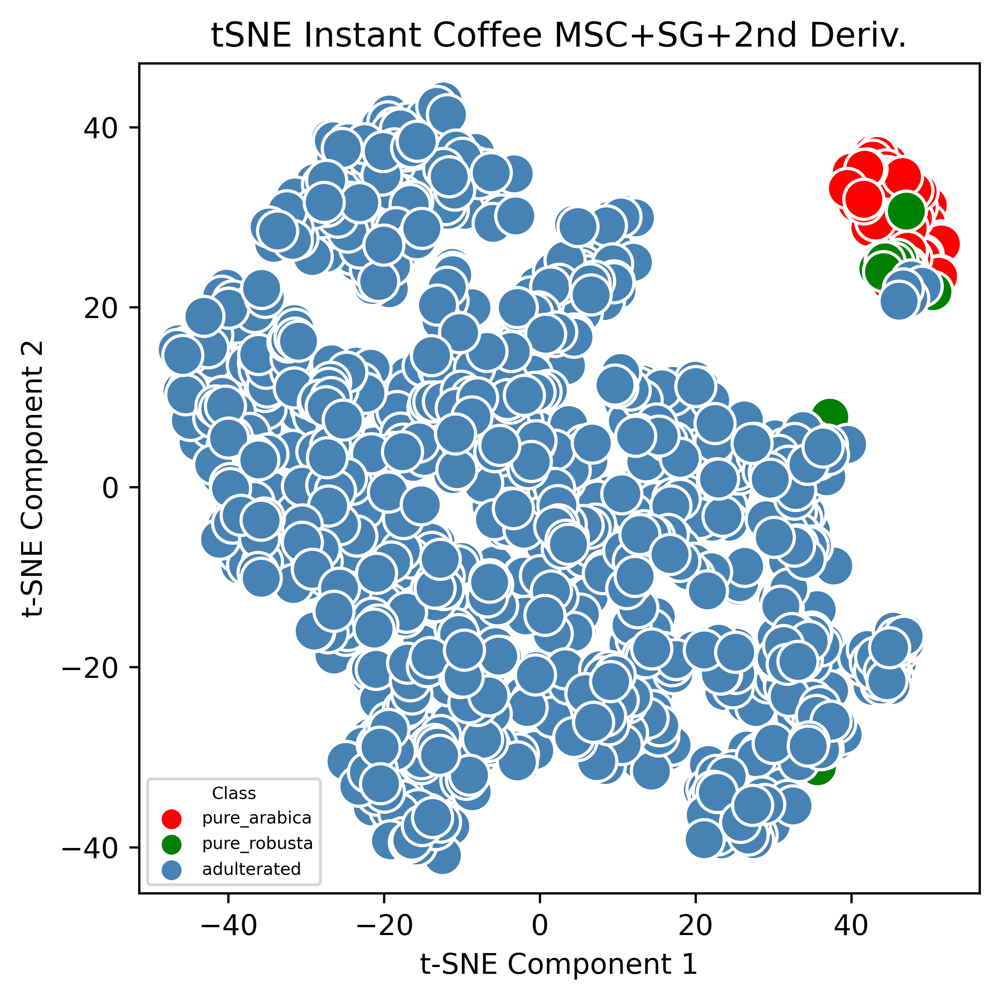

In [15]:
# Plotting 
plt.figure(figsize=(5, 5), dpi=600)

palette = {"adulterated": "steelblue", "pure_arabica": "red", "pure_robusta": "green"}
# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'Class',
                palette=palette, alpha=1.0, s=200)
plt.title("tSNE Instant Coffee MSC+SG+2nd Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title="Class",loc = 'lower left',fontsize=6, title_fontsize=6)
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Instant_MSC_2D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

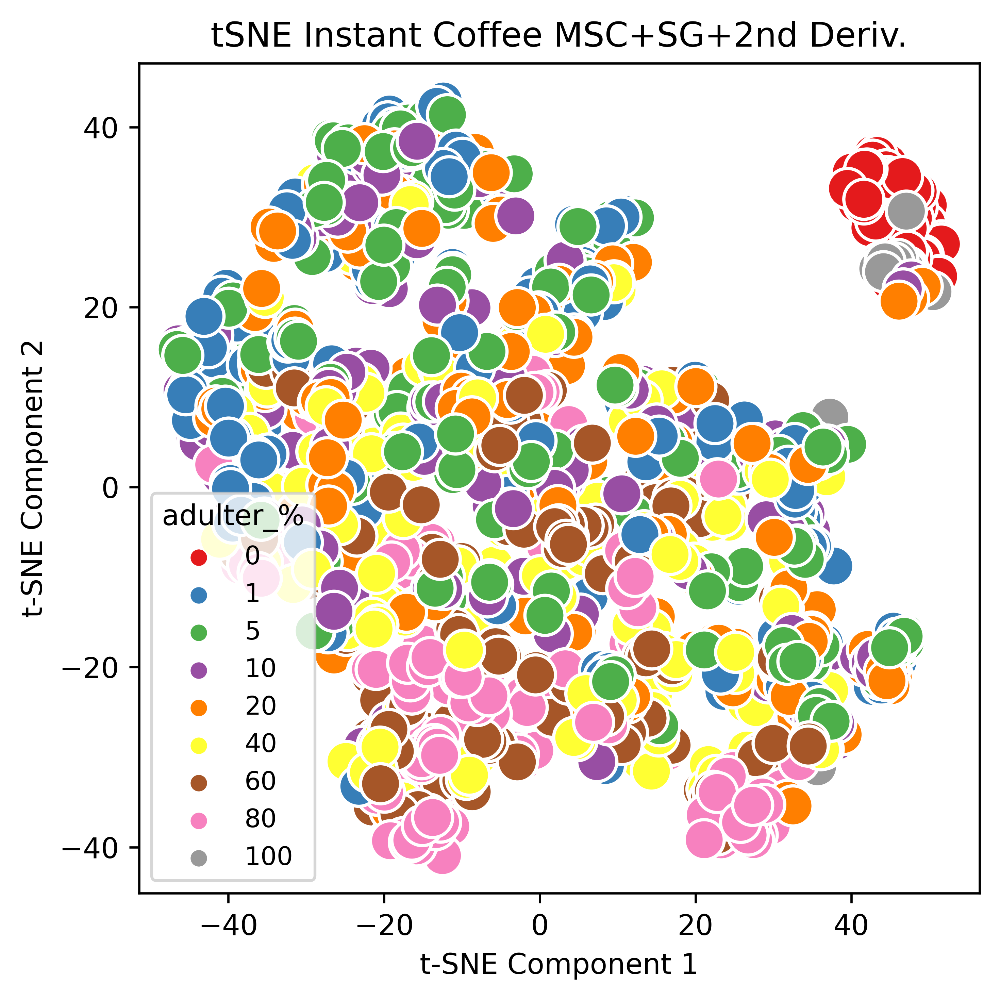

In [16]:
# Plotting 
plt.figure(figsize=(5, 5), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'adulter_percent',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Instant Coffee MSC+SG+2nd Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title='adulter_%', prop={'size': 9}, loc='best', markerscale=0.8)
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Instant_MSC_2D_adult_percent.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

In [17]:
# SNV+SG+first derivative Instant Coffee

# Apply t-SNE to reduce dimensions to 2D
tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42,init='pca')
X_tsne = tsne.fit_transform(X_snv_sg_1d)

# Convert to DataFrame for plotting
tsne_df = pd.DataFrame(X_tsne, columns=['TSNE1', 'TSNE2'])
tsne_df[['Class', 'adulter_percent']] = instant_snv_sg_1d[['three_class','perc_adulter']] 

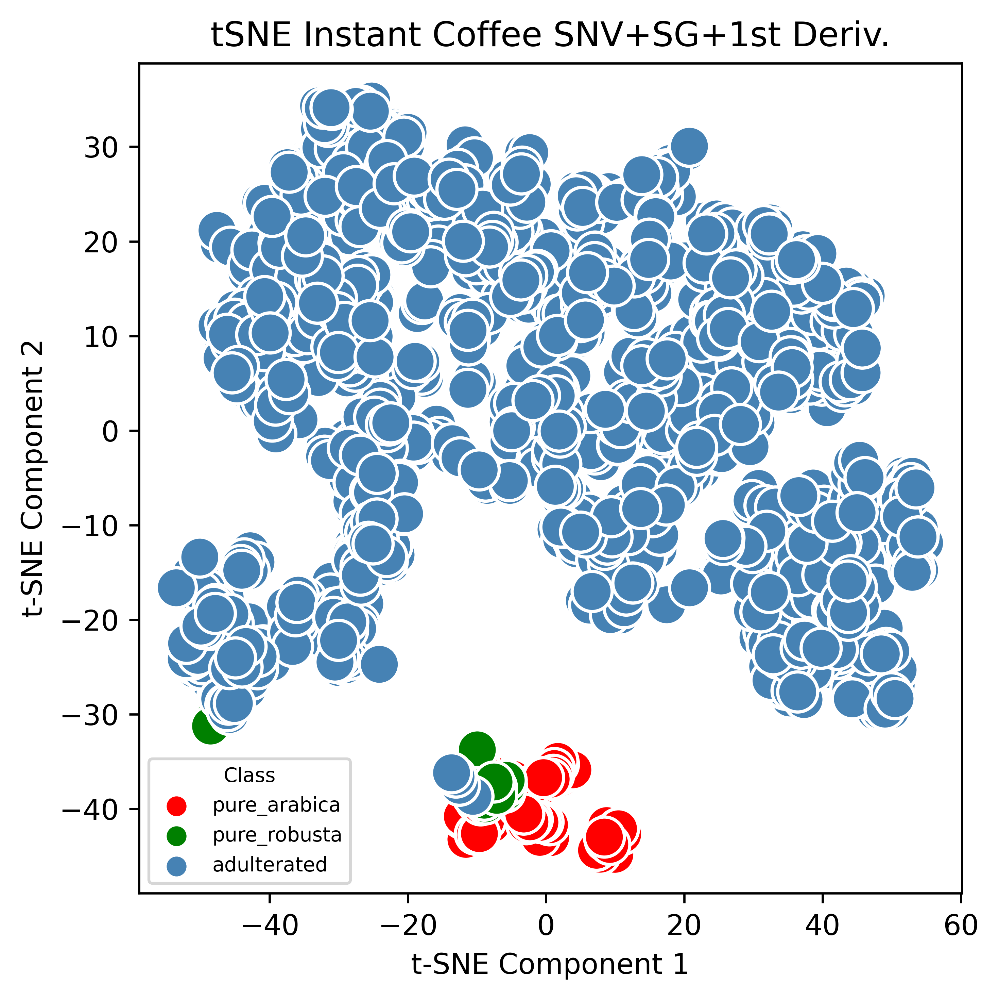

In [18]:
# Plotting 
plt.figure(figsize=(5, 5), dpi=600)

palette = {"adulterated": "steelblue", "pure_arabica": "red", "pure_robusta": "green"}
# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'Class',
                palette=palette, alpha=1.0, s=200)
plt.title("tSNE Instant Coffee SNV+SG+1st Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title="Class", fontsize=7, title_fontsize=7, loc='lower left')
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Instant_SNV_1D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

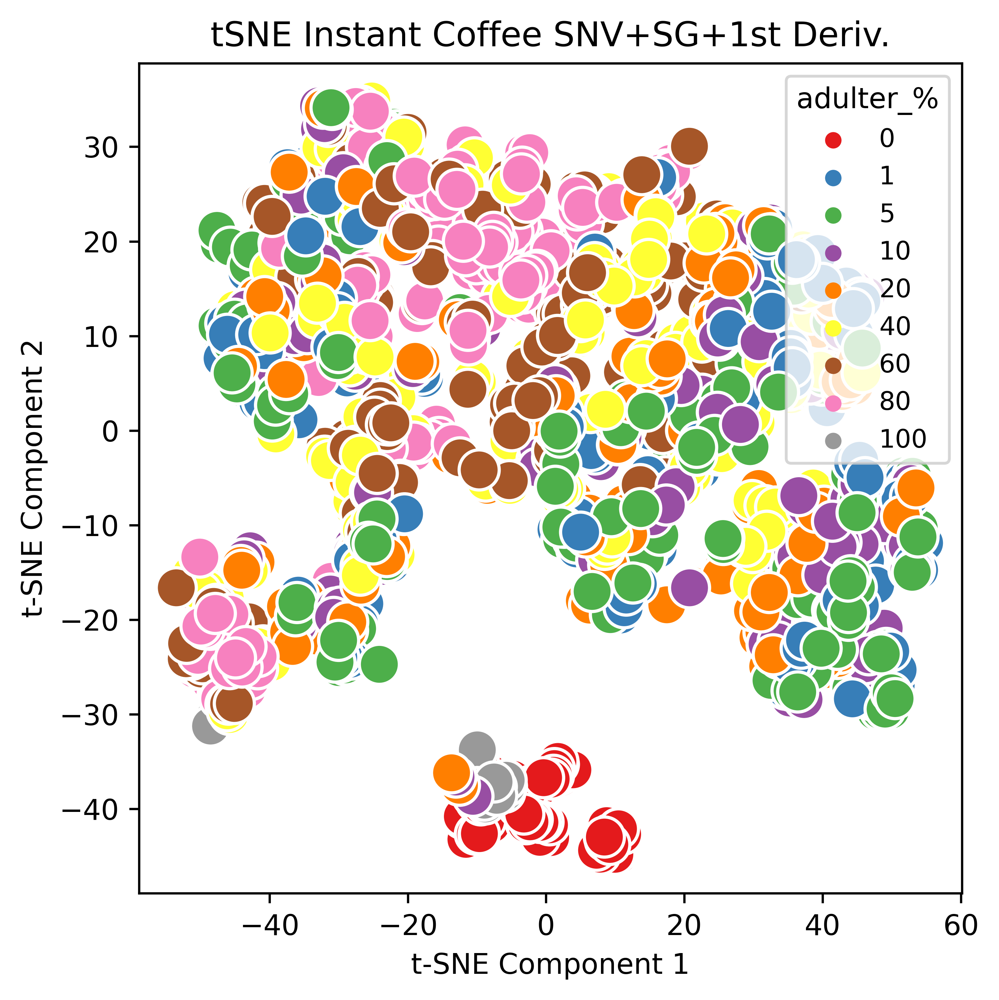

In [19]:
# Plotting 
plt.figure(figsize=(5, 5), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'adulter_percent',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Instant Coffee SNV+SG+1st Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title='adulter_%', prop={'size': 9}, loc='best', markerscale=0.8)
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Instant_SNV_1D_adult_percent.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

In [20]:
# SNV+SG+second derivative Instant Coffee

# Apply t-SNE to reduce dimensions to 2D
tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42,init='pca')
X_tsne = tsne.fit_transform(X_snv_sg_2d)

# Convert to DataFrame for plotting
tsne_df = pd.DataFrame(X_tsne, columns=['TSNE1', 'TSNE2'])
tsne_df[['Class', 'adulter_percent']] = instant_snv_sg_2d[['three_class','perc_adulter']] 

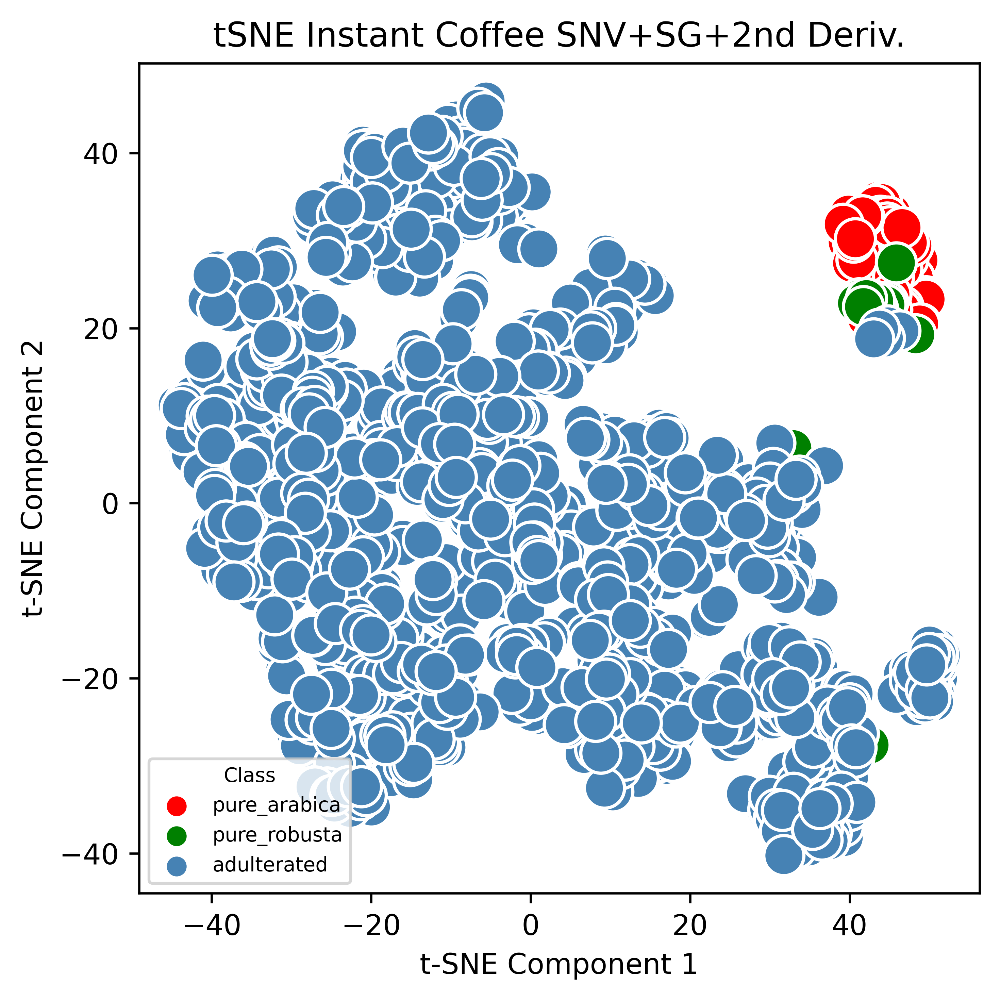

In [21]:
# Plotting 
plt.figure(figsize=(5, 5), dpi=600)

palette = {"adulterated": "steelblue", "pure_arabica": "red", "pure_robusta": "green"}

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'Class',
                palette=palette, alpha=1.0, s=200)
plt.title("tSNE Instant Coffee SNV+SG+2nd Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title="Class", prop={'size': 7}, loc = 'lower left', fontsize=7, title_fontsize=7)
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Instant_SNV_2D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

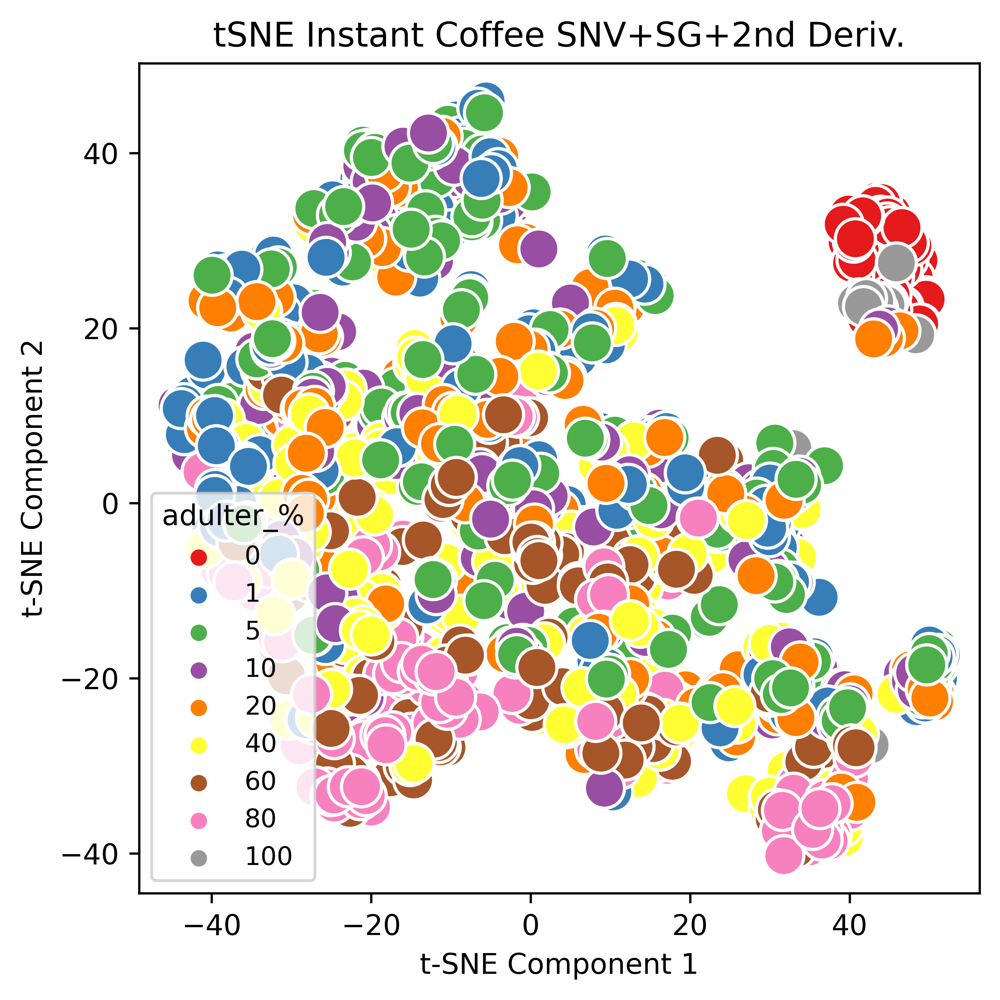

In [22]:
# Plotting 
plt.figure(figsize=(5, 5), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'adulter_percent',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Instant Coffee SNV+SG+2nd Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title='adulter_%', prop={'size': 9}, loc='lower left', markerscale=0.8)
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Instant_SNV_2D_adult_percent.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

### Principal Component Analyis

In [24]:
# Subset columns for aesthetics
columns = instant_raw[['binary_class','three_class','perc_adulter']]

In [25]:
# Raw Spectra data 

# Run PCA
pca = PCA(n_components=0.99)
pca_raw = pca.fit_transform(X_raw_scaled)

# Create a dataframe
pca_raw_df = pd.DataFrame(pca_raw, columns = ['PC1','PC2','PC3'])
pca_raw_df[['binary_class','three_class','adult_percent']] = columns

pca_raw_df.head(5)

,PC1,PC2,PC3,binary_class,three_class,adult_percent
0,10.067356,4.568623,5.484754,pure_arabica,pure_arabica,0
1,10.903091,4.372314,5.461795,pure_arabica,pure_arabica,0
2,10.641775,3.917128,5.313304,pure_arabica,pure_arabica,0
3,16.025809,8.960843,4.861415,pure_arabica,pure_arabica,0
4,15.282418,8.763996,4.695814,pure_arabica,pure_arabica,0


In [26]:
# Explained variance of each principal component
explained_variance = pca.explained_variance_ratio_
print(f"Explained variance by PC1: {explained_variance[0]:.3f}")
print(f"Explained variance by PC2: {explained_variance[1]:.3f}")
print(f"Explained variance by PC3: {explained_variance[2]:.3f}")

Explained variance by PC1: 0.889
Explained variance by PC2: 0.097
Explained variance by PC3: 0.011


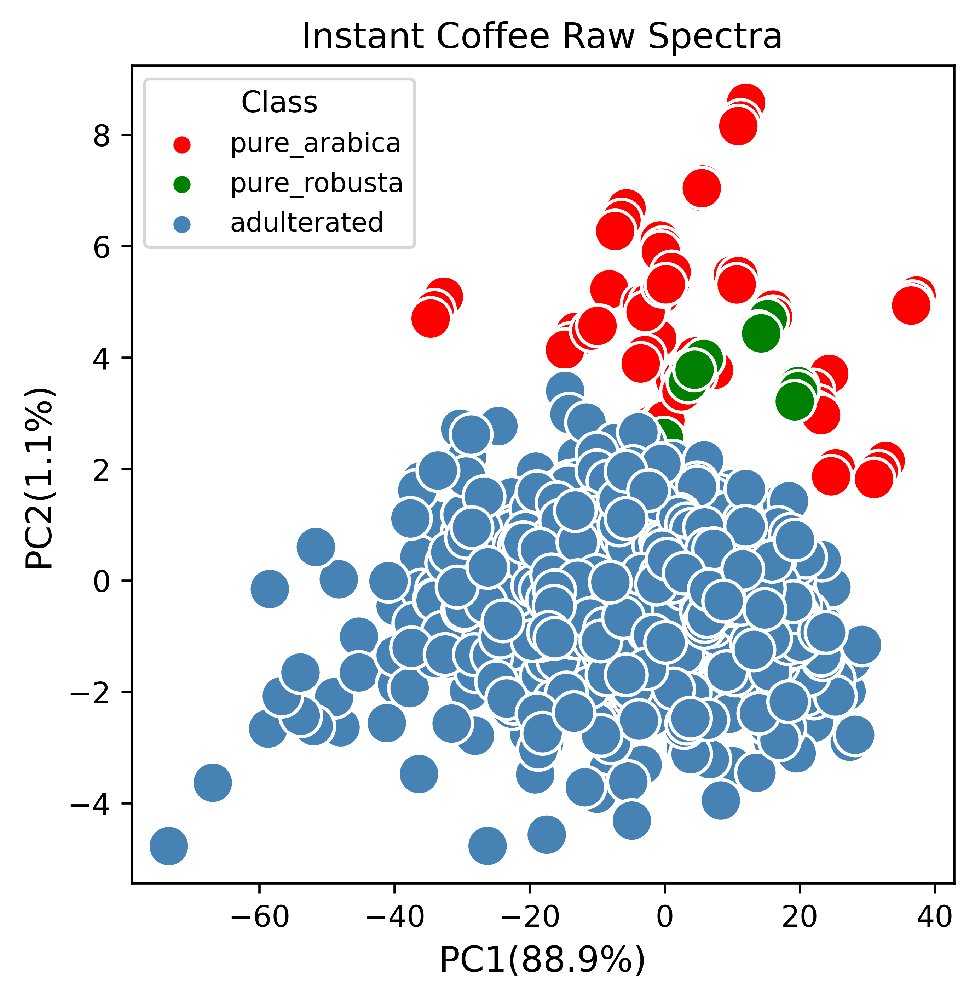

In [27]:
# Create figure
palette = {"adulterated": "steelblue", "pure_arabica": "red", "pure_robusta": "green"}
plt.figure(figsize=(5, 5), dpi=600)
sns.scatterplot(data=pca_raw_df, x='PC1', y='PC3', hue='three_class',
                palette=palette, alpha=1.0, s=200)
plt.title('Instant Coffee Raw Spectra', fontsize=12)  
plt.xlabel('PC1(88.9%)', fontsize=12)
plt.ylabel('PC2(1.1%)', fontsize=12)
plt.legend(title='Class', prop={'size': 9}, loc='upper left', markerscale=0.8)
plt.savefig("PCA_Instant_Raw.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

In [28]:
# MSC+SG+1st derivative Spectra  

# Run PCA
pca = PCA(n_components=0.99)
pca_msc_1d = pca.fit_transform(X_msc_sg_1d)


# Create a dataframe
pca_msc_1d_df = pd.DataFrame(pca_msc_1d, columns = ['PC1','PC2','PC3','PC4','PC5','PC6','PC7'])
pca_msc_1d_df[['binary_class','three_class','adult_percent']] = columns

pca_msc_1d_df.head(5)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,binary_class,three_class,adult_percent
0,-0.000778,-0.008225,0.002436,0.000213,-0.000730,0.001054,0.000304,pure_arabica,pure_arabica,0
1,-0.000996,-0.008285,0.001533,-0.000600,-0.000353,0.001127,0.000610,pure_arabica,pure_arabica,0
2,-0.001604,-0.008405,0.003351,-0.000587,-0.000251,0.000919,0.000607,pure_arabica,pure_arabica,0
3,0.003513,-0.008114,0.002444,-0.000106,-0.000545,0.001167,0.000387,pure_arabica,pure_arabica,0
4,0.003541,-0.007789,0.002584,-0.000666,-0.000334,0.001321,0.000504,pure_arabica,pure_arabica,0


In [29]:
# Explained variance of each principal component
explained_variance = pca.explained_variance_ratio_
print(f"Explained variance by PC1: {explained_variance[0]:.3f}")
print(f"Explained variance by PC2: {explained_variance[1]:.3f}")
print(f"Explained variance by PC3: {explained_variance[2]:.3f}")
print(f"Explained variance by PC4: {explained_variance[3]:.3f}")
print(f"Explained variance by PC5: {explained_variance[4]:.3f}")
print(f"Explained variance by PC6: {explained_variance[5]:.3f}")
print(f"Explained variance by PC7: {explained_variance[6]:.3f}")

Explained variance by PC1: 0.609
Explained variance by PC2: 0.210
Explained variance by PC3: 0.123
Explained variance by PC4: 0.024
Explained variance by PC5: 0.012
Explained variance by PC6: 0.009
Explained variance by PC7: 0.005


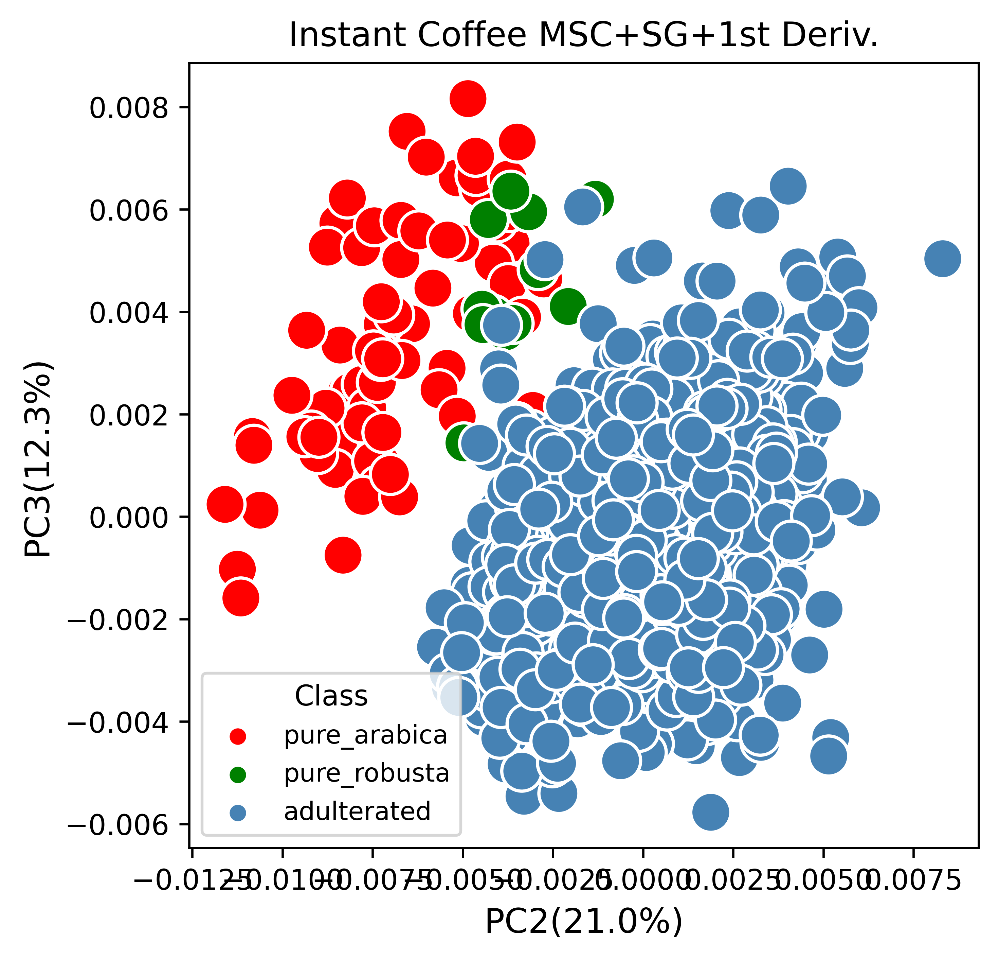

In [30]:
# Create scatter plot
palette = {"adulterated": "steelblue", "pure_arabica": "red", "pure_robusta": "green"}

plt.figure(figsize=(5, 5), dpi=600)
sns.scatterplot(data=pca_msc_1d_df, x='PC2', y='PC3', hue='three_class',
                palette=palette, alpha=1.0, s=200)
plt.title('Instant Coffee MSC+SG+1st Deriv.', fontsize=12)  
plt.xlabel('PC2(21.0%)', fontsize=12)
plt.ylabel('PC3(12.3%)', fontsize=12)
plt.legend(title='Class', prop={'size': 9}, loc='lower left', markerscale=0.8)
plt.savefig("PCA_Instant_MSC_SG_1D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

In [31]:
# MSC+SG+2nd derivative Spectra  

# Run PCA
pca = PCA(n_components=0.99)
pca_msc_2d = pca.fit_transform(X_msc_sg_2d)


# Create a dataframe
pca_msc_2d_df = pd.DataFrame(pca_msc_2d, columns = ['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8'])
pca_msc_2d_df[['binary_class','three_class','adult_percent']] = columns

pca_msc_2d_df.head(5)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,binary_class,three_class,adult_percent
0,0.001462,0.001061,0.000132,-0.000137,0.000152,0.000186,0.000021,-0.000102,pure_arabica,pure_arabica,0
1,0.001444,0.000851,0.000193,-0.000032,0.000198,0.000247,-0.000033,-0.000099,pure_arabica,pure_arabica,0
2,0.001652,0.001177,0.000013,-0.000019,0.000183,0.000226,-0.000043,-0.000057,pure_arabica,pure_arabica,0
3,0.001024,0.001369,0.000231,-0.000094,0.000146,0.000244,0.000021,-0.000026,pure_arabica,pure_arabica,0
4,0.000976,0.001376,0.000204,-0.000012,0.000177,0.000270,-0.000015,-0.000023,pure_arabica,pure_arabica,0


In [32]:
# Explained variance of each principal component
explained_variance = pca.explained_variance_ratio_
print(f"Explained variance by PC1: {explained_variance[0]:.3f}")
print(f"Explained variance by PC2: {explained_variance[1]:.3f}")
print(f"Explained variance by PC3: {explained_variance[2]:.3f}")
print(f"Explained variance by PC4: {explained_variance[3]:.3f}")
print(f"Explained variance by PC5: {explained_variance[4]:.3f}")
print(f"Explained variance by PC6: {explained_variance[5]:.3f}")
print(f"Explained variance by PC7: {explained_variance[6]:.3f}")
print(f"Explained variance by PC8: {explained_variance[7]:.3f}")

Explained variance by PC1: 0.507
Explained variance by PC2: 0.338
Explained variance by PC3: 0.083
Explained variance by PC4: 0.022
Explained variance by PC5: 0.020
Explained variance by PC6: 0.011
Explained variance by PC7: 0.005
Explained variance by PC8: 0.004


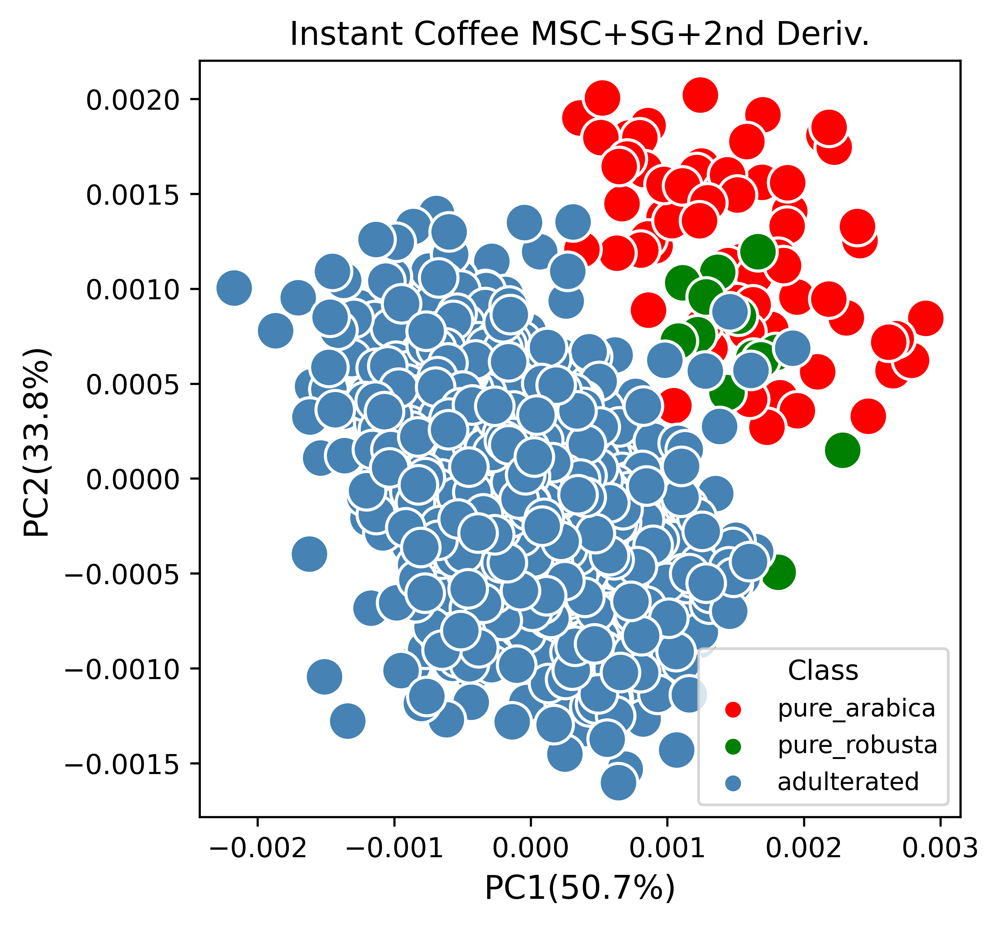

In [33]:
# Create scatter plot
palette = {"adulterated": "steelblue", "pure_arabica": "red", "pure_robusta": "green"}
plt.figure(figsize=(5, 5), dpi=600)
sns.scatterplot(data=pca_msc_2d_df, x='PC1', y='PC2', hue='three_class',
                palette=palette, alpha=1.0, s=200)
plt.title('Instant Coffee MSC+SG+2nd Deriv.', fontsize=12)  
plt.xlabel('PC1(50.7%)', fontsize=12)
plt.ylabel('PC2(33.8%)', fontsize=12)
plt.legend(title='Class', prop={'size': 9}, loc='best', markerscale=0.8) 
plt.savefig("PCA_Instant_MSC_SG_2D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

In [34]:
# SNV+SG+1st derivative Spectra  

# Run PCA
pca = PCA(n_components=0.99)
pca_snv_1d = pca.fit_transform(X_snv_sg_1d)


# Create a dataframe
pca_snv_1d_df = pd.DataFrame(pca_snv_1d, columns = ['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8'])
pca_snv_1d_df[['binary_class','three_class','adult_percent']] = columns

pca_snv_1d_df.head(5)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,binary_class,three_class,adult_percent
0,-0.010814,-0.095460,0.040670,-0.002646,-0.010207,0.014427,0.004153,-0.002640,pure_arabica,pure_arabica,0
1,-0.013590,-0.096666,0.030016,-0.012961,-0.005647,0.014255,0.007979,-0.004193,pure_arabica,pure_arabica,0
2,-0.020998,-0.096150,0.052267,-0.012014,-0.004286,0.011568,0.007532,-0.004674,pure_arabica,pure_arabica,0
3,0.043309,-0.101981,0.035705,-0.002139,-0.006525,0.013042,0.006647,-0.001740,pure_arabica,pure_arabica,0
4,0.043620,-0.097360,0.037339,-0.008917,-0.004102,0.014095,0.008525,-0.002507,pure_arabica,pure_arabica,0


In [35]:
# Explained variance of each principal component
explained_variance = pca.explained_variance_ratio_
print(f"Explained variance by PC1: {explained_variance[0]:.3f}")
print(f"Explained variance by PC2: {explained_variance[1]:.3f}")
print(f"Explained variance by PC3: {explained_variance[2]:.3f}")
print(f"Explained variance by PC4: {explained_variance[3]:.3f}")
print(f"Explained variance by PC5: {explained_variance[4]:.3f}")
print(f"Explained variance by PC6: {explained_variance[5]:.3f}")
print(f"Explained variance by PC7: {explained_variance[6]:.3f}")
print(f"Explained variance by PC8: {explained_variance[7]:.3f}")

Explained variance by PC1: 0.582
Explained variance by PC2: 0.230
Explained variance by PC3: 0.124
Explained variance by PC4: 0.025
Explained variance by PC5: 0.012
Explained variance by PC6: 0.009
Explained variance by PC7: 0.005
Explained variance by PC8: 0.004


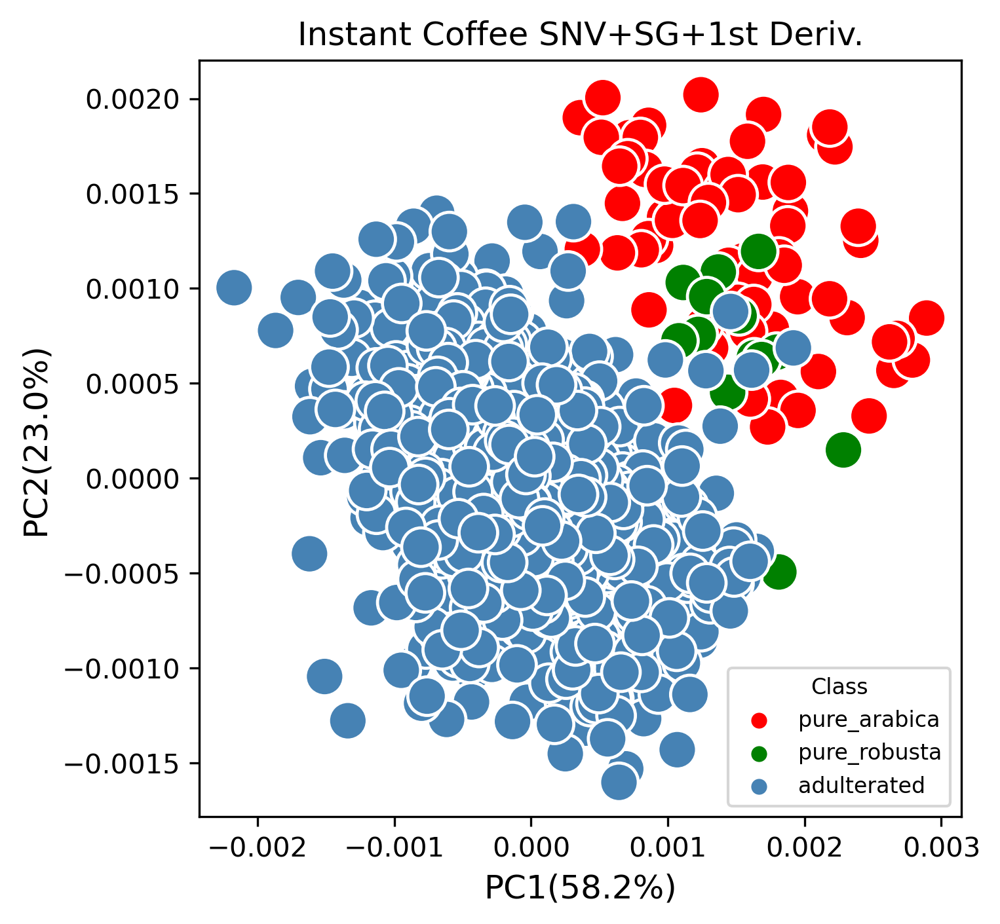

In [36]:
# Create scatter plot
palette = {"adulterated": "steelblue", "pure_arabica": "red", "pure_robusta": "green"}
plt.figure(figsize=(5, 5), dpi=300)
sns.scatterplot(data=pca_msc_2d_df, x='PC1', y='PC2', hue='three_class',
                palette=palette, alpha=1.0, s=200)
plt.title('Instant Coffee SNV+SG+1st Deriv.', fontsize=12)  
plt.xlabel('PC1(58.2%)', fontsize=12)
plt.ylabel('PC2(23.0%)', fontsize=12)
plt.legend(title='Class', prop={'size': 8}, loc='lower right', fontsize=8, title_fontsize =8,  markerscale=0.8)
plt.savefig("PCA_Instant_SNV_SG_1D.png", dpi=300, bbox_inches="tight", format="png")
plt.show()


In [37]:
# SNV+SG+1st derivative Spectra  

# Run PCA
pca = PCA(n_components=0.99)
pca_snv_2d = pca.fit_transform(X_snv_sg_2d)


# Create a dataframe
pca_snv_2d_df = pd.DataFrame(pca_snv_2d, columns = ['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8'])
pca_snv_2d_df[['binary_class','three_class','adult_percent']] = columns

pca_snv_2d_df.head(5)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,binary_class,three_class,adult_percent
0,0.018174,0.012510,0.000946,-0.000622,0.002345,0.002375,0.000171,-0.001450,pure_arabica,pure_arabica,0
1,0.017870,0.009927,0.001615,0.000815,0.002508,0.003123,-0.000492,-0.001409,pure_arabica,pure_arabica,0
2,0.020488,0.013866,-0.000634,0.000844,0.002248,0.002872,-0.000609,-0.000878,pure_arabica,pure_arabica,0
3,0.013736,0.016172,0.003175,-0.000591,0.002255,0.002779,0.000242,-0.000293,pure_arabica,pure_arabica,0
4,0.013114,0.016280,0.002797,0.000468,0.002314,0.003088,-0.000186,-0.000232,pure_arabica,pure_arabica,0


In [38]:
# Explained variance of each principal component
explained_variance = pca.explained_variance_ratio_
print(f"Explained variance by PC1: {explained_variance[0]:.3f}")
print(f"Explained variance by PC2: {explained_variance[1]:.3f}")
print(f"Explained variance by PC3: {explained_variance[2]:.3f}")
print(f"Explained variance by PC4: {explained_variance[3]:.3f}")
print(f"Explained variance by PC5: {explained_variance[4]:.3f}")
print(f"Explained variance by PC6: {explained_variance[5]:.3f}")
print(f"Explained variance by PC7: {explained_variance[6]:.3f}")
print(f"Explained variance by PC8: {explained_variance[7]:.3f}")

Explained variance by PC1: 0.515
Explained variance by PC2: 0.328
Explained variance by PC3: 0.086
Explained variance by PC4: 0.022
Explained variance by PC5: 0.020
Explained variance by PC6: 0.011
Explained variance by PC7: 0.005
Explained variance by PC8: 0.004


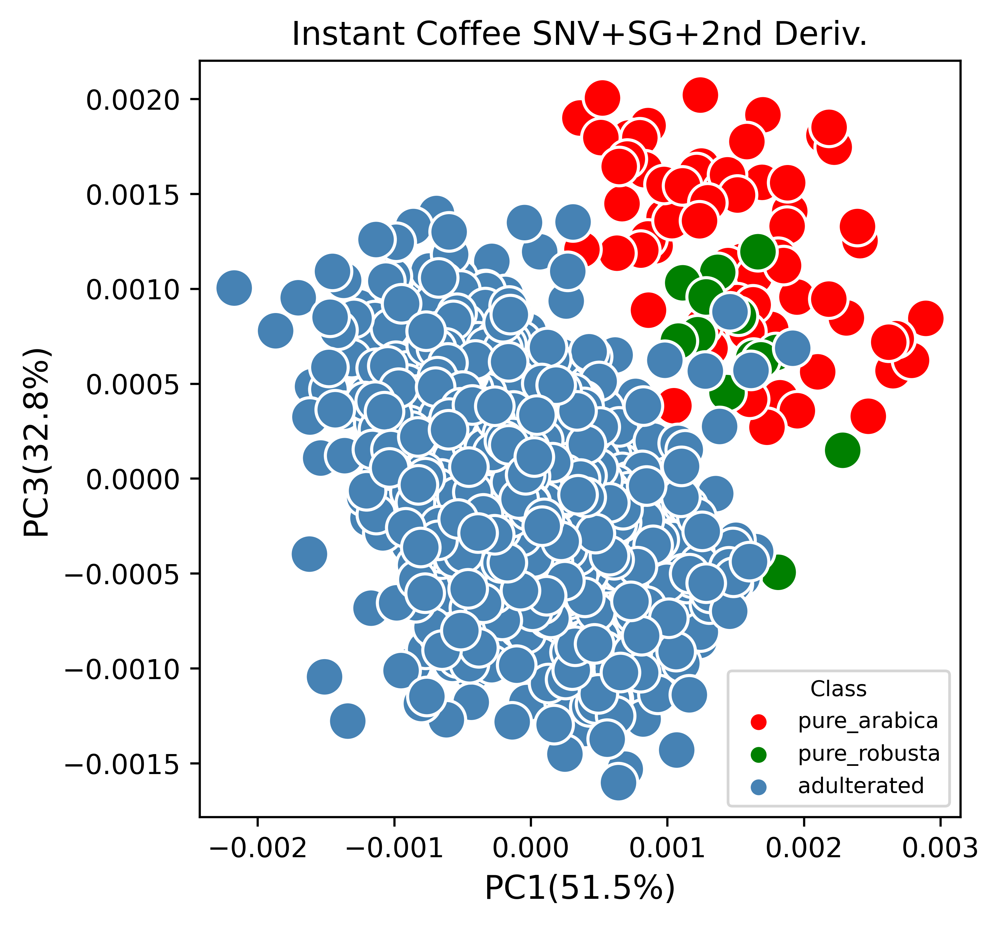

In [39]:
# Create scatter plot
palette = {"adulterated": "steelblue", "pure_arabica": "red", "pure_robusta": "green"}
plt.figure(figsize=(5, 5), dpi=600)
sns.scatterplot(data=pca_msc_2d_df, x='PC1', y='PC2', hue='three_class',
                palette=palette, alpha=1.0, s=200)
plt.title('Instant Coffee SNV+SG+2nd Deriv.', fontsize=12)  
plt.xlabel('PC1(51.5%)', fontsize=12)
plt.ylabel('PC3(32.8%)', fontsize=12)
plt.legend(title='Class', prop={'size': 8}, loc='lower right', markerscale=0.8, fontsize=8, title_fontsize=8)
plt.savefig("PCA_Instant_SNV_SG_2D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()
